## IOWA UNIVERSITY https://mesonet.agron.iastate.edu/request/download.phtml?network=ES__ASOS

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [1]:
#@title Get metar
station = "LEVX" #@param {type:"string"}
from_year = "2018" #@param {type:"string"}
from_month = "01" #@param {type:"string"}
from_day = "01" #@param {type:"string"}
to_year = "2022" #@param {type:"string"}
to_month = "12" #@param {type:"string"}
to_day = "31" #@param {type:"string"}

import pandas as pd
import numpy as np

s1="https://mesonet.agron.iastate.edu/cgi-bin/request/asos.py?station="
OACI=station
#s2="&data=drct&data=sknt"
s2="&data=all"
s3="&year1="+from_year+"&month1="+from_month+"&day1="+from_day
s4="&year2="+to_year+"&month2="+to_month+"&day2="+to_day
s5="&tz=Etc%2FUTC&format=onlycomma&latlon=no&missing=M&trace=T&direct=no&report_type=1&report_type=2"
url=s1+OACI+s2+s3+s4+s5
df=pd.read_csv(url,parse_dates=["valid"],).rename({"valid":"time"},axis=1)
df

<ipython-input-1-011c8f2ca8f4>:21: DtypeWarning: Columns (6,8,10) have mixed types. Specify dtype option on import or set low_memory=False.
  df=pd.read_csv(url,parse_dates=["valid"],).rename({"valid":"time"},axis=1)


,station,time,tmpf,dwpf,relh,drct,sknt,p01i,alti,mslp,...,wxcodes,ice_accretion_1hr,ice_accretion_3hr,ice_accretion_6hr,peak_wind_gust,peak_wind_drct,peak_wind_time,feel,metar,snowdepth
0,LEVX,2018-01-01 00:00:00,46.40,44.60,93.40,200.00,7.00,0.0,30.45,M,...,M,M,M,M,M,M,M,42.33,LEVX 010000Z 20007KT 170V240 9999 SCT031 BKN03...,M
1,LEVX,2018-01-01 00:30:00,48.20,44.60,87.28,190.00,6.00,0.0,30.42,M,...,M,M,M,M,M,M,M,45.04,LEVX 010030Z 19006KT 100V230 9999 BKN030 09/07...,M
2,LEVX,2018-01-01 01:00:00,48.20,44.60,87.28,190.00,8.00,0.0,30.42,M,...,M,M,M,M,M,M,M,44.07,LEVX 010100Z 19008KT 160V220 9999 BKN030 09/07...,M
3,LEVX,2018-01-01 01:30:00,48.20,46.40,93.45,190.00,7.00,0.0,30.42,M,...,M,M,M,M,M,M,M,44.53,LEVX 010130Z 19007KT 140V230 9999 BKN030 09/08...,M
4,LEVX,2018-01-01 02:00:00,48.20,46.40,93.45,190.00,8.00,0.0,30.42,M,...,M,M,M,M,M,M,M,44.07,LEVX 010200Z 19008KT 150V220 9999 BKN030 09/08...,M
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
90052,LEVX,2022-12-30 21:30:00,59.00,53.60,82.25,200.00,22.00,0.0,30.06,M,...,M,M,M,M,M,M,M,59.00,LEVX 302130Z 20022KT 150V230 9999 BKN017 OVC01...,M
90053,LEVX,2022-12-30 22:00:00,59.00,53.60,82.25,190.00,16.00,0.0,30.06,M,...,M,M,M,M,M,M,M,59.00,LEVX 302200Z 19016G26KT 140V220 9999 FEW015 BK...,M
90054,LEVX,2022-12-30 22:30:00,59.00,53.60,82.25,190.00,17.00,0.0,30.06,M,...,M,M,M,M,M,M,M,59.00,LEVX 302230Z 19017KT 150V220 9999 FEW014 BKN01...,M
90055,LEVX,2022-12-30 23:00:00,59.00,53.60,82.25,200.00,18.00,0.0,30.06,M,...,M,M,M,M,M,M,M,59.00,LEVX 302300Z 20018G29KT 160V220 9999 SCT015 BK...,M


In [ ]:
!pip install klib
import klib

In [2]:
df.columns

Index(['station', 'time', 'tmpf', 'dwpf', 'relh', 'drct', 'sknt', 'p01i',
       'alti', 'mslp', 'vsby', 'gust', 'skyc1', 'skyc2', 'skyc3', 'skyc4',
       'skyl1', 'skyl2', 'skyl3', 'skyl4', 'wxcodes', 'ice_accretion_1hr',
       'ice_accretion_3hr', 'ice_accretion_6hr', 'peak_wind_gust',
       'peak_wind_drct', 'peak_wind_time', 'feel', 'metar', 'snowdepth'],
      dtype='object')

In [ ]:
#today metar
from datetime import timedelta
today=pd.to_datetime("today")
# today
OACI="LEVX"

#url string
s1="https://mesonet.agron.iastate.edu/cgi-bin/request/asos.py?station="
s2="&data=all"
s3="&year1="+today.strftime("%Y")+"&month1="+today.strftime("%m")+"&day1="+today.strftime("%d")
s4="&year2="+today.strftime("%Y")+"&month2="+today.strftime("%m")+"&day2="+today.strftime("%d")
s5="&tz=Etc%2FUTC&format=onlycomma&latlon=no&missing=M&trace=T&direct=no&report_type=1&report_type=2"
url=s1+OACI+s2+s3+s4+s5
df=pd.read_csv(url,parse_dates=["valid"],).rename({"valid":"time"},axis=1)
df[["time","metar"]].set_index("time")

,metar
time,
2021-06-25 00:00:00,LEVX 250000Z 03003KT CAVOK 19/12 Q1020 NOSIG
2021-06-25 00:30:00,LEVX 250030Z VRB02KT CAVOK 18/13 Q1020 NOSIG
2021-06-25 01:00:00,LEVX 250100Z 00000KT CAVOK 18/13 Q1020 NOSIG
2021-06-25 01:30:00,LEVX 250130Z 23004KT CAVOK 18/13 Q1020 NOSIG
2021-06-25 02:00:00,LEVX 250200Z 24003KT 200V280 CAVOK 18/13 Q1019...
2021-06-25 02:30:00,LEVX 250230Z 24006KT CAVOK 18/13 Q1019 NOSIG
2021-06-25 03:00:00,LEVX 250300Z 23005KT 200V280 CAVOK 17/13 Q1019...
2021-06-25 03:30:00,LEVX 250330Z 25005KT 180V280 CAVOK 17/13 Q1019...
2021-06-25 04:00:00,LEVX 250400Z 24005KT 210V280 CAVOK 16/13 Q1019...


In [3]:
#temperature  dry and dew to Kelvin scale. Fixing errors
df["temp_o"]= round(((pd.to_numeric(df["tmpf"], downcast="float",errors='coerce'))-32)*(5/9)+273.15,0)
df["tempd_o"]=round(((pd.to_numeric(df["dwpf"], downcast="float",errors='coerce'))-32)*(5/9)+273.15,0)
df.loc[df.temp_o>320,"temp_o"]=np.nan
df.loc[df.tempd_o<260,"tempd_o"]=np.nan
#df.loc[df.time=="2017-07-16 00:30:00","temp_o"]=np.nan
print((df.temp_o-df.tempd_o).describe())
print((df[["temp_o","tempd_o"]]-273).describe())
import plotly.express as px
fig = px.line(df,x="time",y="tempd_o", title="temp_o figure")
fig.show()


count    89933.000000
mean         3.721204
std          3.753068
min          0.000000
25%          1.000000
50%          3.000000
75%          6.000000
max         31.000000
dtype: float64
             temp_o       tempd_o
count  89943.000000  89934.000000
mean      14.428938     10.707874
std        5.718662      4.641619
min       -3.000000    -13.000000
25%       10.000000      8.000000
50%       14.000000     11.000000
75%       18.000000     14.000000
max       38.000000     26.000000


In [4]:
import plotly.express as px

fig = px.line(df,x="time",y="temp_o", title="tempd_o figure")
fig.show()

In [5]:
#rh. Fixing errors time yy-mm-dd HH:MM:SS
df["rh_o"]=pd.to_numeric(df["relh"], downcast="float",errors='coerce')
df.loc[df.rh_o>100,"rh_o"]=np.nan
#df.loc[df.time=="2017-07-16 00:30:00","rh_o"]=np.nan
print(df["rh_o"].describe())
import plotly.express as px
fig = px.line(df,x="time",y="rh_o", title="rh_o figure")
fig.show()


count    89848.000000
mean        80.561913
std         16.613926
min          9.110000
25%         69.139999
50%         82.739998
75%         93.650002
max        100.000000
Name: rh_o, dtype: float64


In [6]:
#assign -1 to variable winds represented as M
df["dir_o"]=pd.to_numeric(df["drct"], downcast="float",errors='ignore')
df.loc[df.dir_o=="M","dir_o"]=-1.0
df.loc[:,"dir_o"]=pd.to_numeric(df["dir_o"], downcast="float",errors='coerce')
print(df[["dir_o","metar"]].sample(100))
print(df["dir_o"].describe())


       dir_o                                              metar
19666  230.0  LEVX 010300Z 23019G40KT 190V300 8000 -RA BKN02...
19597  250.0  LEVX 301830Z 25009KT 190V300 0050 R19/1900U R0...
23390  220.0  LEVX 180500Z 22005KT 9999 SCT016 BKN026 10/10 ...
46792   10.0  LEVX 052100Z 01006KT 350V050 CAVOK 21/16 Q1013...
37811  190.0  LEVX 031230Z 19007KT 150V240 CAVOK 19/11 Q1028...
...      ...                                                ...
33310   -1.0  LEVX 060030Z VRB01KT 9999 BKN050 10/10 Q1020 N...
63080   -1.0  LEVX 301130Z VRB02KT 9999 FEW026 21/14 Q1018 N...
7192   360.0  LEVX 242300Z 36006KT CAVOK 17/15 Q1013 TEMPO S...
89986  210.0  LEVX 291230Z 21003KT 150V250 2100 0500E DZ BCF...
15502  180.0  LEVX 091330Z 18015KT 140V220 0100 R19/0275N R0...

[100 rows x 2 columns]
count    90057.000000
mean       156.032410
std        116.863663
min         -1.000000
25%         20.000000
50%        190.000000
75%        240.000000
max        360.000000
Name: dir_o, dtype: float64


<ipython-input-6-206f74794790>:4: DeprecationWarning:

In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`



In [ ]:
import plotly.express as px
fig = px.line(df,x="time",y="dir_o", title="dir_o figure")
fig.show()


In [8]:
# wind speed to m/s
df["spd_o"] = pd.to_numeric(df["sknt"], downcast="float",errors='coerce') * 0.514444
#df[["spd_o","metar"]].sample(100)
#df.loc[df.time=="2010-01-01 11:00:00",["spd_o","metar"]]=np.nan
#df.loc[df.time=="2010-01-01 11:00:00",["spd_o","metar"]]
df[["spd_o","metar"]].sample(20)

,spd_o,metar
61795,1.543332,LEVX 040530Z 03003KT 010V070 CAVOK 08/07 Q1024...
28349,5.144440,LEVX 291130Z 28010KT 230V320 9999 SCT019 BKN03...
64045,1.028888,LEVX 200530Z VRB02KT 0500 R19/P2000 R01/1500U ...
44350,2.572220,LEVX 160500Z 17005KT 130V220 5000 -RADZ BR FEW...
12494,1.028888,LEVX 091130Z 14002KT CAVOK 24/17 Q1021 TEMPO B...
44306,1.543332,LEVX 150700Z 18003KT 120V230 9999 0800SE BCFG ...
3784,7.716660,LEVX 161400Z 25015G27KT 210V280 9999 FEW025TCU...
25849,3.086664,LEVX 071830Z 32006KT 260V020 9999 FEW032 15/07...
14064,5.144440,LEVX 111930Z 19010KT CAVOK 15/11 Q1013 NOSIG
33055,4.629996,LEVX 010534Z 22009KT 190V250 4500 BCFG RA BKN0...


In [9]:
import plotly.express as px
fig = px.line(df,x="time",y="spd_o", title="spd_o figure")
fig.show()



count     90057
unique       40
top           M
freq      86340
Name: wind_gust_o, dtype: object


1589     7.202216
2624            M
49454           M
55536           M
43988           M
21477           M
80240           M
60739           M
85998           M
17429           M
63299           M
63790           M
85810           M
46510           M
52589           M
72904           M
27181           M
41491           M
69231           M
60569           M
23198           M
37953           M
52187           M
42917           M
14427           M
63983           M
8993            M
52408           M
88051           M
87606           M
Name: wind_gust_o, dtype: object

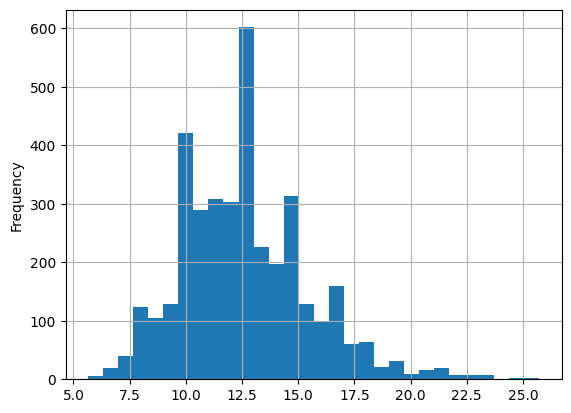

In [10]:
#wind gust assign nan when no gust. units m/s
df["wind_gust_o"]=pd.to_numeric(df["gust"], downcast="float",errors='coerce')*0.514444

df.loc[df.wind_gust_o<0,"wind_gust_o"]="M"
#mask = (df.time > '2011-08-01') & (df.time <= '2011-11-05') & (df.wind_gust_o<0)
#df.loc[mask,["wind_gust_o","metar_o","time"]].set_index("time")
df["wind_gust_o"]=df["wind_gust_o"].fillna("M")
print(df["wind_gust_o"].describe())

pd.to_numeric(df["wind_gust_o"],downcast="float",errors="coerce").plot(kind="hist",bins=30,grid=True);

df.wind_gust_o.sample(30)

In [ ]:
import plotly.express as px
fig = px.line(df,x="time",y="wind_gust_o", title="wind_gust_o figure")
fig.show()


In [ ]:
#One hour precipitation for the period from the observation time to the time of the previous hourly precipitation reset.
#This value may or may not contain frozen precipitation melted by some device on the sensor or estimated by some other means
#transformed from inches to mm
df["prec_o"]=pd.to_numeric(df["p01i"], downcast="float",errors='coerce')*25.4
print(df["prec_o"].describe())

import plotly.express as px
fig = px.line(df,x="time",y="prec_o", title="Var figure")
fig.show()

In [11]:
#QNH in hpa
df["mslp_o"]=round(pd.to_numeric(df["alti"], downcast="float",errors='coerce')*33.8638,0)
df.loc[df.mslp_o<900,"mslp_o"]=np.nan
df.loc[df.mslp_o>1100,"mslp_o"]=np.nan
print(df["mslp_o"].describe())
print(df.loc[df["time"]=="2013-01-19 06:30:00",["mslp_o","metar"]])
print(df[["mslp_o","metar"]])

import plotly.express as px
fig = px.line(df,x="time",y="mslp_o", title="mslp_o figure")
fig.show()

count    90051.000000
mean      1017.902039
std          6.911282
min        976.000000
25%       1015.000000
50%       1018.000000
75%       1022.000000
max       1036.000000
Name: mslp_o, dtype: float64
Empty DataFrame
Columns: [mslp_o, metar]
Index: []
       mslp_o                                              metar
0      1031.0  LEVX 010000Z 20007KT 170V240 9999 SCT031 BKN03...
1      1030.0  LEVX 010030Z 19006KT 100V230 9999 BKN030 09/07...
2      1030.0  LEVX 010100Z 19008KT 160V220 9999 BKN030 09/07...
3      1030.0  LEVX 010130Z 19007KT 140V230 9999 BKN030 09/08...
4      1030.0  LEVX 010200Z 19008KT 150V220 9999 BKN030 09/08...
...       ...                                                ...
90052  1018.0  LEVX 302130Z 20022KT 150V230 9999 BKN017 OVC01...
90053  1018.0  LEVX 302200Z 19016G26KT 140V220 9999 FEW015 BK...
90054  1018.0  LEVX 302230Z 19017KT 150V220 9999 FEW014 BKN01...
90055  1018.0  LEVX 302300Z 20018G29KT 160V220 9999 SCT015 BK...
90056  1018.0  LEVX 302330Z 1

In [ ]:
#Sea Level Pressure in hPa . Unknown. Data are incompletely
pd.to_numeric(df["mslp"], downcast="float",errors='coerce').describe()


count    30121.000000
mean      1017.220886
std          7.230199
min        974.299988
25%       1014.200012
50%       1018.000000
75%       1021.299988
max       1037.699951
Name: mslp, dtype: float64

       visibility_o                                              metar
1356         9994.0       LEVX 270730Z VRB02KT CAVOK 05/04 Q1035 NOSIG
69566        9994.0  LEVX 101200Z 19005KT 120V230 CAVOK 16/12 Q1019...
40609        9994.0  LEVX 302300Z 07012G24KT 030V120 CAVOK 05/M04 Q...
60059        9994.0       LEVX 300130Z 04005KT CAVOK 07/05 Q1012 NOSIG
27959        9994.0       LEVX 211100Z VRB02KT CAVOK 25/17 Q1021 NOSIG
83366        9994.0  LEVX 190330Z 21005KT 150V260 CAVOK 16/10 Q1019...
62828        9994.0  LEVX 250600Z 23005KT 190V260 CAVOK 16/13 Q1019...
4760         9994.0  LEVX 050830Z 20008KT 140V220 CAVOK 09/08 Q1016...
21072        3492.0  LEVX 012134Z VRB01KT 3500 BCFG -DZ BKN009 BKN0...
10779        9994.0  LEVX 051030Z 20005KT 070V240 CAVOK 31/22 Q1017...
44504        9994.0  LEVX 191000Z VRB04KT 9999 FEW030 18/10 Q1021 N...
75318        9994.0       LEVX 062130Z 03007KT CAVOK 06/03 Q1017 NOSIG
79580        8996.0  LEVX 020649Z 22005KT 9000 0600E DZ BCFG BKN036...
85171 

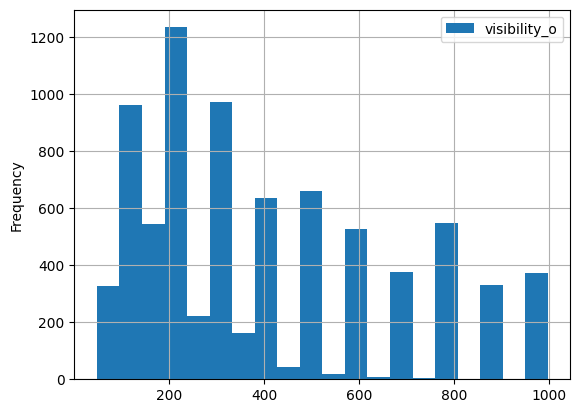

In [12]:
#visibility in meters
df["visibility_o"]=round(pd.to_numeric(df["vsby"], downcast="float",errors='coerce')*1609.344,0)
df.loc[df.visibility_o<=0,"visibility_o"]=np.nan
df.loc[df.visibility_o>9999,"visibility_o"]=9999
print(df[["visibility_o","metar"]].sample(20))
print(df["visibility_o"].describe())
df.loc[df.visibility_o<=1000,["visibility_o"]].plot(kind="hist",grid=True,bins=20);
import plotly.express as px
fig = px.line(df,x="time",y="visibility_o", title="Var figure")
fig.show()


In [13]:
#pd.to_numeric(df["skyl1"], downcast="float",errors='ignore').sample(100)
#df[["skyc1","skyl1","skyc2","skyl2","skyc3","skyl3","skyc4","skyl4","metar"]].sample(30)
df["skyc1_o"]=df["skyc1"]
df["skyc2_o"]=df["skyc2"]
df["skyc3_o"]=df["skyc3"]
df["skyl1_o"]=round(pd.to_numeric(df["skyl1"], downcast="float",errors='coerce')*0.3048,0)
df["skyl1_o"]=df.skyl1_o.fillna(-1)
df.loc[df.skyl1_o>2000,"skyl1_o"]=np.nan
df["skyl1_o"]=df["skyl1_o"].replace(-1,"M")
print(df[["skyl1_o","metar"]].describe())
print(df[["skyl1_o","metar"]].sample(30))
df["skyl2_o"]=round(pd.to_numeric(df["skyl2"], downcast="float",errors='coerce')*0.3048,0)
df["skyl2_o"]=df.skyl2_o.fillna("M")
print(df[["skyl2_o","metar"]].describe())
df["skyl3_o"]=round(pd.to_numeric(df["skyl3"], downcast="float",errors='coerce')*0.3048,0)
df["skyl3_o"]=df.skyl3_o.fillna("M")
print(df[["skyl3_o","metar"]].describe())
df["skyl4_o"]=round(pd.to_numeric(df["skyl4"], downcast="float",errors='coerce')*0.3048,0)
df["skyl4_o"]=df.skyl4_o.fillna("M")
print(df[["skyl4_o","metar"]].describe())

import plotly.express as px
fig = px.line(df,x="time",y="skyl4_o", title="Var figure")
fig.show()

       skyl1_o                                         metar
count    90055                                         90057
unique      59                                         90055
top          M  LEVX 300500Z VRB01KT CAVOK 12/10 Q1018 NOSIG
freq     38585                                             2
      skyl1_o                                              metar
62798       M       LEVX 241500Z VRB03KT CAVOK 28/11 Q1020 NOSIG
29364  1402.0  LEVX 182230Z 02010KT 340V060 9999 BKN046 16/11...
21327  1524.0  LEVX 062230Z VRB01KT 9999 SCT050 06/05 Q1014 T...
72844       M       LEVX 142300Z VRB01KT CAVOK 05/02 Q1028 NOSIG
60771    61.0  LEVX 140430Z VRB02KT 9000 0600N R19/250D R19/2...
67455  1006.0  LEVX 272200Z VRB02KT 9999 BKN033 14/12 Q1023 N...
7670    671.0  LEVX 031530Z 25011KT 210V280 9999 BKN022 BKN03...
13155       M       LEVX 230000Z 01004KT CAVOK 18/17 Q1024 NOSIG
57753   671.0  LEVX 131730Z 28004KT 230V350 9999 SCT022 BKN02...
48704       M       LEVX 132100Z VRB01KT CAVO

In [14]:
#wxcodes
pd.options.display.max_rows=100
df.wxcodes.value_counts(normalize=True).map(lambda n: '{:.2%}'.format(n))
df["wxcodes_o"]=df["wxcodes"]

In [15]:
#metar
df["metar_o"]=df["metar"]

In [16]:
#last review
print(df[['time','temp_o','tempd_o', 'rh_o', 'dir_o', 'spd_o', 'wind_gust_o','mslp_o',
       'visibility_o', 'skyc1_o', 'skyc2_o', 'skyc3_o', 'skyl1_o', 'skyl2_o',
       'skyl3_o', 'wxcodes_o', 'metar_o']].info())
df[['time','temp_o','tempd_o', 'rh_o', 'dir_o', 'spd_o', 'wind_gust_o','mslp_o',
       'visibility_o', 'skyc1_o', 'skyc2_o', 'skyc3_o', 'skyl1_o', 'skyl2_o',
       'skyl3_o', 'wxcodes_o', 'metar_o']].describe()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 90057 entries, 0 to 90056
Data columns (total 17 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   time          90057 non-null  datetime64[ns]
 1   temp_o        89943 non-null  float32       
 2   tempd_o       89934 non-null  float32       
 3   rh_o          89848 non-null  float32       
 4   dir_o         90057 non-null  float32       
 5   spd_o         90047 non-null  float32       
 6   wind_gust_o   90057 non-null  object        
 7   mslp_o        90051 non-null  float32       
 8   visibility_o  90008 non-null  float32       
 9   skyc1_o       90057 non-null  object        
 10  skyc2_o       90057 non-null  object        
 11  skyc3_o       90057 non-null  object        
 12  skyl1_o       90055 non-null  object        
 13  skyl2_o       90057 non-null  object        
 14  skyl3_o       90057 non-null  object        
 15  wxcodes_o     90027 non-null  object

,temp_o,tempd_o,rh_o,dir_o,spd_o,mslp_o,visibility_o
count,89943.000000,89934.000000,89848.000000,90057.000000,90047.000000,90051.000000,90008.000000
mean,287.428925,283.707886,80.561913,156.032410,3.011749,1017.902039,8306.778320
std,5.718662,4.641619,16.613926,116.863663,1.910452,6.911282,3202.649902
min,270.000000,260.000000,9.110000,-1.000000,0.000000,976.000000,48.000000
25%,283.000000,281.000000,69.139999,20.000000,1.543332,1015.000000,8996.000000
50%,287.000000,284.000000,82.739998,190.000000,2.572220,1018.000000,9994.000000
75%,291.000000,287.000000,93.650002,240.000000,4.115552,1022.000000,9994.000000
max,311.000000,299.000000,100.000000,360.000000,17.491096,1036.000000,9994.000000


In [17]:
df=df.drop_duplicates(subset="time")

In [21]:
#save results
#from google.colab import drive
#drive.mount('/content/drive')
df[['time','temp_o','tempd_o', 'rh_o', 'dir_o', 'spd_o', 'wind_gust_o','mslp_o',
       'visibility_o', 'skyc1_o', 'skyc2_o', 'skyc3_o', 'skyl1_o', 'skyl2_o',
       'skyl3_o', 'wxcodes_o', 'metar_o']].to_csv("LEVXY2018Y2022.csv")

In [18]:
df[['time','temp_o','tempd_o', 'rh_o', 'dir_o', 'spd_o', 'wind_gust_o','mslp_o',
       'visibility_o', 'skyc1_o', 'skyc2_o', 'skyc3_o', 'skyl1_o', 'skyl2_o',
       'skyl3_o', 'wxcodes_o', 'metar_o']]

,time,temp_o,tempd_o,rh_o,dir_o,spd_o,wind_gust_o,mslp_o,visibility_o,skyc1_o,skyc2_o,skyc3_o,skyl1_o,skyl2_o,skyl3_o,wxcodes_o,metar_o
0,2018-01-01 00:00:00,281.0,280.0,93.400002,200.0,3.601108,M,1031.0,9994.0,SCT,BKN,M,945.0,1158.0,M,M,LEVX 010000Z 20007KT 170V240 9999 SCT031 BKN03...
1,2018-01-01 00:30:00,282.0,280.0,87.279999,190.0,3.086664,M,1030.0,9994.0,BKN,M,M,914.0,M,M,M,LEVX 010030Z 19006KT 100V230 9999 BKN030 09/07...
2,2018-01-01 01:00:00,282.0,280.0,87.279999,190.0,4.115552,M,1030.0,9994.0,BKN,M,M,914.0,M,M,M,LEVX 010100Z 19008KT 160V220 9999 BKN030 09/07...
3,2018-01-01 01:30:00,282.0,281.0,93.449997,190.0,3.601108,M,1030.0,9994.0,BKN,M,M,914.0,M,M,M,LEVX 010130Z 19007KT 140V230 9999 BKN030 09/08...
4,2018-01-01 02:00:00,282.0,281.0,93.449997,190.0,4.115552,M,1030.0,9994.0,BKN,M,M,914.0,M,M,M,LEVX 010200Z 19008KT 150V220 9999 BKN030 09/08...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
90052,2022-12-30 21:30:00,288.0,285.0,82.250000,200.0,11.317768,M,1018.0,9994.0,BKN,OVC,M,518.0,579.0,M,M,LEVX 302130Z 20022KT 150V230 9999 BKN017 OVC01...
90053,2022-12-30 22:00:00,288.0,285.0,82.250000,190.0,8.231104,13.375544,1018.0,9994.0,FEW,BKN,OVC,457.0,549.0,640.0,M,LEVX 302200Z 19016G26KT 140V220 9999 FEW015 BK...
90054,2022-12-30 22:30:00,288.0,285.0,82.250000,190.0,8.745548,M,1018.0,9994.0,FEW,BKN,OVC,427.0,518.0,610.0,M,LEVX 302230Z 19017KT 150V220 9999 FEW014 BKN01...
90055,2022-12-30 23:00:00,288.0,285.0,82.250000,200.0,9.259992,14.918876,1018.0,9994.0,SCT,BKN,OVC,457.0,518.0,610.0,M,LEVX 302300Z 20018G29KT 160V220 9999 SCT015 BK...


In [19]:
df.to_csv("LEVXY2018Y2022.csv")

In [ ]:
data=collections.Counter(df["wxcodes"])
data_sorted = {k: v for k, v in sorted(data.items(), key=lambda x: x[1])}
print(data_sorted)

NameError: ignored